<h1>Adversarial attack implementation and testing</h1>

The images used in this notebook come from the Imagenet ILSCVR2012 challenge dataset as "Test images (all tasks)" with
the 10/10/2019 patch applied. The full dataset may be downloaded here:
https://image-net.org/challenges/LSVRC/2012/2012-downloads.php

Insert the images into "test_images/test" directory.

<h2>Preliminaries (Required)</h2>

<h4>Imports</h4>

In [1]:
"""
Required imports.
"""
import torch
import torch.nn
import torch.nn.functional as functional
from torch.utils.data import Dataset, DataLoader
import torchvision.models as models
import torchvision.datasets as datasets
from PIL import Image
from torchvision import transforms
import numpy as np
import requests, io
import matplotlib.pyplot as plt
from torch.autograd import Variable
import json
import time
import os, os.path

#Import my created utility functions
from utility_functions import zero_gradients, visualise, tracing_start, trace_peak_memory

#Import deepfool provided by the researchers
from deepfool import deepfool

<h4>Defining settings</h4>

In [2]:
"""
Matplotlib settings.
"""
%matplotlib inline
from matplotlib import style
style.use('fivethirtyeight')

In [3]:
"""
Define mean and standard deviation for the imagenet images. The values have been caluclated and are the standard for
normalization of images for all models.   
"""
MEAN=[0.485, 0.456, 0.406]
STD=[0.229, 0.224, 0.225]

In [4]:
"""
Locate the directory where test images are and calculate number of images.
"""
TEST_DIR = 'test_images\\test'

num_images = (len([name for name in os.listdir(TEST_DIR) if os.path.isfile(os.path.join(TEST_DIR, name))]))


<h4>Loading Imagenet labels and model</h4>

In [5]:
"""
Load the class labels from the JSON file.
"""
with open('imagenet-simple-labels.json') as json_file:
    labels = json.load(json_file)

In [6]:
"""
Download if not already present and load the EfficientNEt-B7 model using PyTorch.
"""
model = models.efficientnet_b7(pretrained=True)
model.eval();

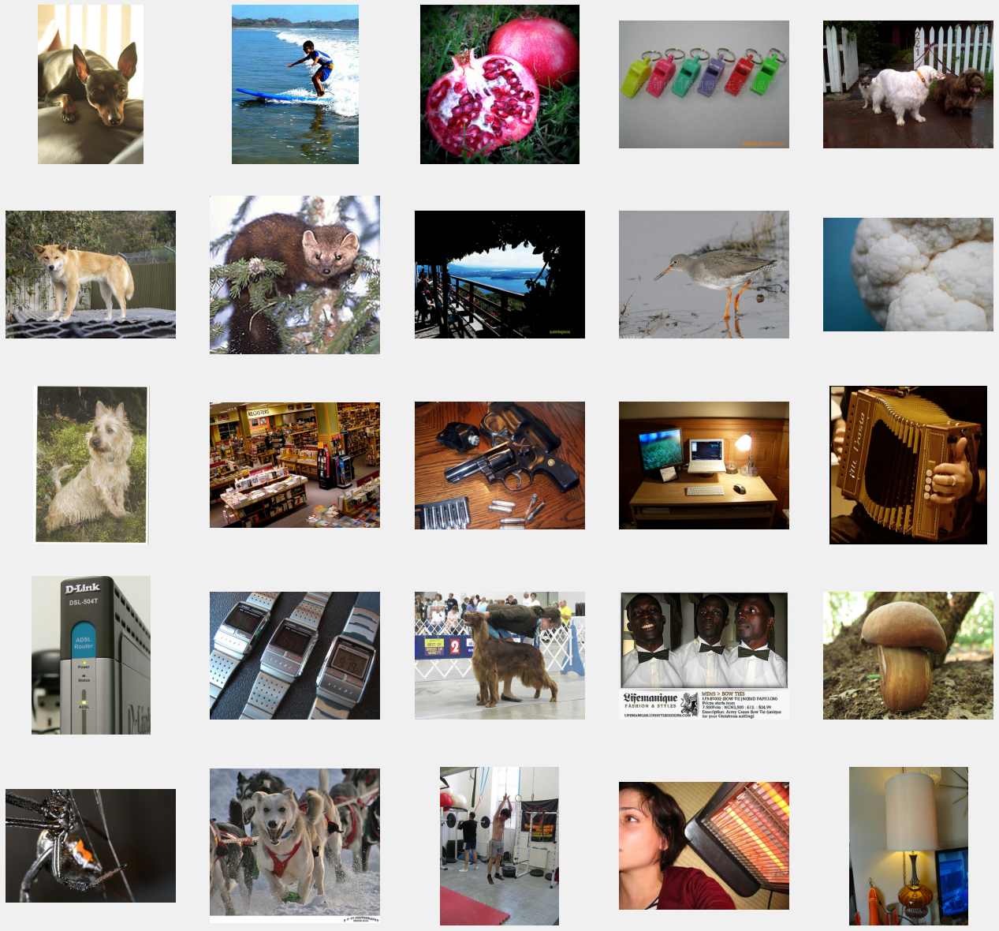

In [22]:
"""
Load 25 random images from the test set to showcase using PIL.
"""
input_images = [] #Create empty list to store images in
showcase_images = []

for i in range(75): #Loop through 100 times

    x = str(np.random.randint(num_images)) #Generate random number as string
    x = (x.zfill(8)) #Zero pad random number to 8 digits

    imgname = TEST_DIR + '\ILSVRC2012_test_' + x + '.jpeg' #Create image file path

    input_images.append(Image.open(imgname).convert('RGB')) #Append the image opened using PIL and converted to RGB

plt.figure(figsize=(20,20)) #Specifying the overall grid size

for i in range(25):
    x = str(np.random.randint(num_images)) #Generate random number as string
    x = (x.zfill(8)) #Zero pad random number to 8 digits

    imgname = TEST_DIR + '\ILSVRC2012_test_' + x + '.jpeg' #Create image file path

    showcase_images.append(Image.open(imgname).convert('RGB')) #Append the image opened using PIL and converted to RGB

for i in range(len(showcase_images)): #Loop through all 25 images
    plt.subplot(5,5,i+1)    #The number of images in the grid is 5*5 (25)
    plt.imshow(showcase_images[i]) #Show the image
    plt.grid(None) #Disable the grid lines on the image
    plt.axis('off') #Disable the axis
plt.show() #Show the grid

<h2>Image classification (Required)</h2>

<h4>Defining preprocessing steps</h4>

In [13]:
"""
Define the preprocessing steps using the transforms module of torchvision.
"""
preprocess = transforms.Compose([transforms.Resize((300,300)), #Resize the image to 300 x 300
                                 transforms.ToTensor(), #Convert the image to a tensor
                                 transforms.Normalize(MEAN, STD)]) #Normalise the image about the mean and standard
                                                                   #deviation of imagenet

<h4>Function to handle classification of unperturbed images</h4>

In [14]:
def classify_input_image(image):
    """Predict the class and probabilities of the input image.

    Args:
        image (PIL.JpegImagePlugin.JpegImageFile): Input image loaded using PIL.

    Returns:
        image_tensor (torch.Tensor): Input image in tensor form.
        image_variable (torch.Tensor): Input image as variable, allows easier computation of gradients.
        output (torch.Tensor): Tensor of the output of the classification.
        label_idx (int): Index of the largest element of the output, represents the most likely class.
        x_pred (str): Name of the most likely class as a string.
        x_pred_prob (float): Probability that the input is the predicted class.
    """
    image_tensor = preprocess(image) #Preprocess the input image allowing classification
    image_tensor = image_tensor.unsqueeze(0) #Add a dimension of size 1 to the start (0th position) of the tensor
    image_variable = Variable(image_tensor, requires_grad=True) #Convert the image tensor into a pytorch variable
    
    output = model.forward(image_variable) #Perform a model forward pass on the image variable (prediction)
    label_idx = int(torch.max(output.data, 1)[1][0])  #Get the index of the maximum probability
    x_pred = labels[label_idx] #Get the corresponding class name from the label index
    
    output_probs = functional.softmax(output, dim=1) #Get the full output of probabilities
    x_pred_prob =  float((torch.max(output_probs.data, 1)[0][0]) * 100) #Get the probability with highest value
    
    return image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs

<h4>Function to handle classification of perturbed images</h4>

In [15]:
def classify_adv(imgVar):
    """Predict the class and probabilities of the adversarial image.

    Args:
        imgVar (torch.Tensor): Adversarial image as PyTorch variable.

    Returns:
        adv_pred (str): Name of the most likely class as a string.
        adv_pred_prob (float): Probability that the input is the predicted class.
    """
    
    output_adv = model.forward(imgVar) #Perform a model forward pass on the image variable (prediction)
    adv_pred_int = int(torch.max(output_adv.data, 1)[1][0]) #Get the index of the maximum probability
    adv_pred = labels[adv_pred_int] #Get the corresponding class name from the label index
    
    op_adv_probs = functional.softmax(output_adv, dim=1) #Get the full output of probabilities
    adv_pred_prob =  float((torch.max(op_adv_probs.data, 1)[0][0]) * 100) #Get the probability with highest value
    
    return adv_pred, adv_pred_prob

<h4>Demonstration</h4>

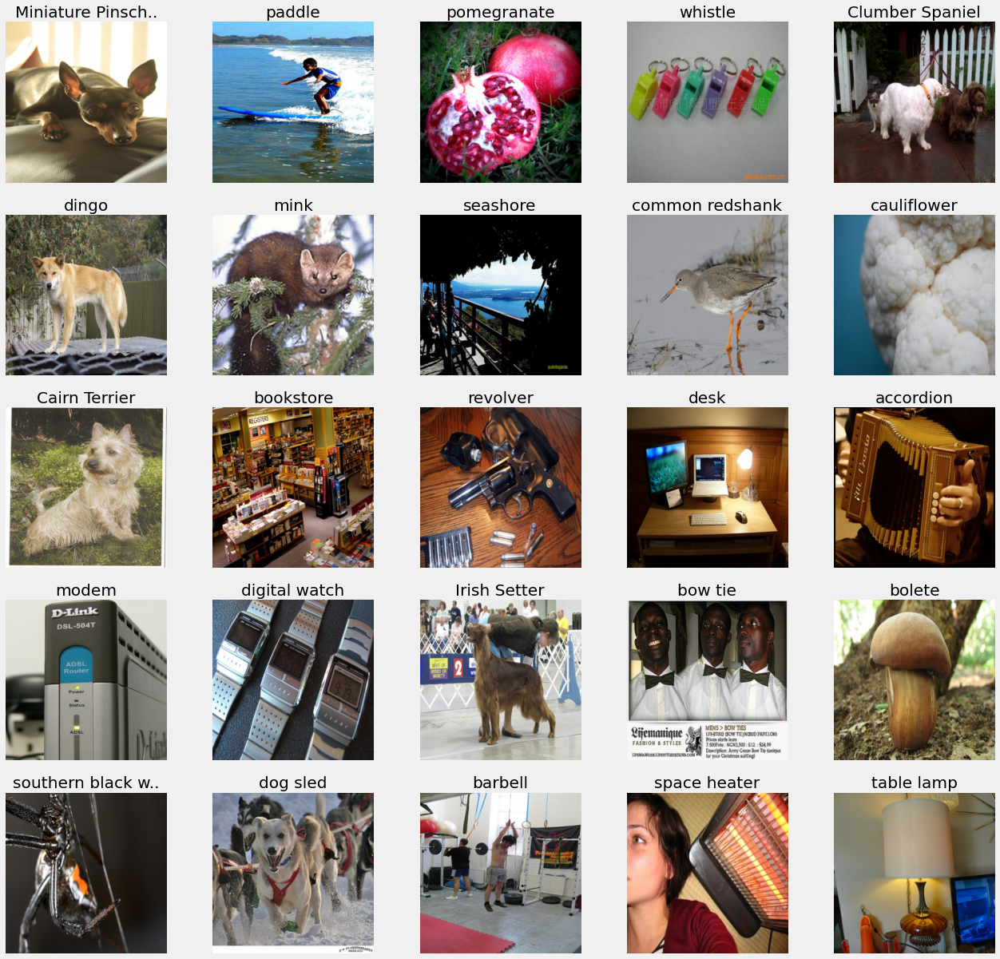

In [23]:
orig_pred = []

plt.figure(figsize=(20,20)) #Specifying the overall grid size

for i in range(len(showcase_images)): #Loop through all 25 images
    
    image_tensor, _, _, _, x_pred, _, _ = classify_input_image(showcase_images[i]) #Classify the input image
    
    image_tensor = image_tensor.squeeze(0) #Remove the dimension in the first position
    
    #Perform the reverse of the normalisation process to return the images to their normal appearance
    image_tensor = image_tensor.mul(
        torch.FloatTensor(STD).view(3,1,1)).add(torch.FloatTensor(MEAN).view(3,1,1)).numpy()
    
    image_tensor = np.transpose(image_tensor, (1,2,0)) #Transpose the image to a size it can be shown in using imshow
    image_tensor = np.clip(image_tensor, 0, 1) #Clip the tensor with 0 and 1 as min and max
    
    orig_pred.append(x_pred)
    x_pred = (x_pred[:16] + '..') if len(x_pred) > 16 else x_pred #Truncate the prediction
    
    plt.subplot(5,5,i+1) #The number of images in the grid is 5*5 (25)
    plt.imshow(image_tensor) #Show the image
    plt.title(x_pred)
    plt.grid(None) #Disable the grid lines on the image
    plt.axis('off') #Disable the axis
    
    
plt.show() #Show the grid

<h2>Fast Sign Gradient Method (FGSM) (Optional)</h2>

<h4> Implementation function </h4>

In [17]:
def fgsm(label, class_Output, image_variable, epsilon):
    """Caluclate the FGSM attack using the formula

    Args:
        label (int): Int value of the true (predicted) class label of the input image.
        image_variable (torch.Tensor): Variable ouput of the classification.
        class_Output: (torch.Tensor) Ouput of the classification of the input image.
        epsilon (float): The epsilon value to multiply the perturbation by.

    Returns:
        x_grad (torch.Tensor): Calculated perturbation in torch.Tensor form.
        x_fgsm (torch.Tensor): Generated adversarial image in torch.Tensor form.
        epsilon (float): The epsilon value used.
    """
    fgsm_target = Variable(torch.LongTensor([label_idx]), requires_grad=False) #Get the target variable as the true 
                                                                                #(by prediction) label.
    
    #Perform a backward pass in order to get gradients
    fgsm_loss = torch.nn.CrossEntropyLoss()
    fgsm_loss_cal = fgsm_loss(class_Output, fgsm_target) #Calculate cross entropy loss between the output and the target
    fgsm_loss_cal.backward(retain_graph=True) #Calculate gradient of each variable
    
    #Implementing the FGSM formula to create the adversarial image
    x_grad = torch.sign(image_variable.grad.data) #Calculate the sign of gradient of the loss func, perturbation

    x_fgsm = image_variable.data + (epsilon * x_grad) #Add the epsilon multiplied perturbation to the input image
    
    return x_grad, x_fgsm, epsilon

<h4>Demonstration</h4>

<h5>Single image with range of epsilon values</h5>

In [18]:
"""
Define the epsilon values to be tested in the demonstration.
"""
epsilon = [0.01, 0.1, 0.25, 0.5] #List of epsilon values to test

In [25]:
"""
Process and classify the input image.
"""
image = showcase_images[0]
image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)

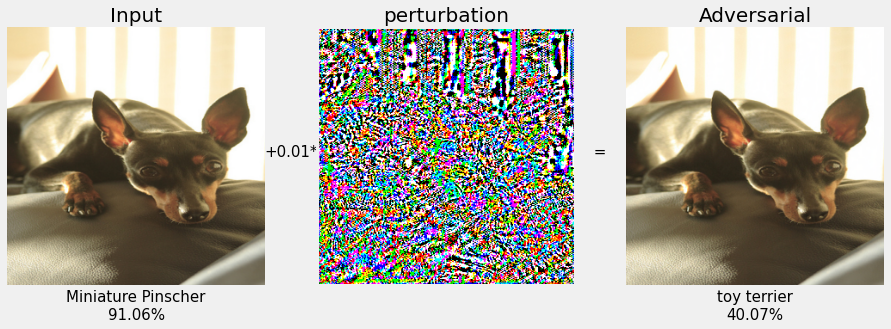

time elapsed 3147 milli seconds
Peak memory usage in MB:  11.465173721313477


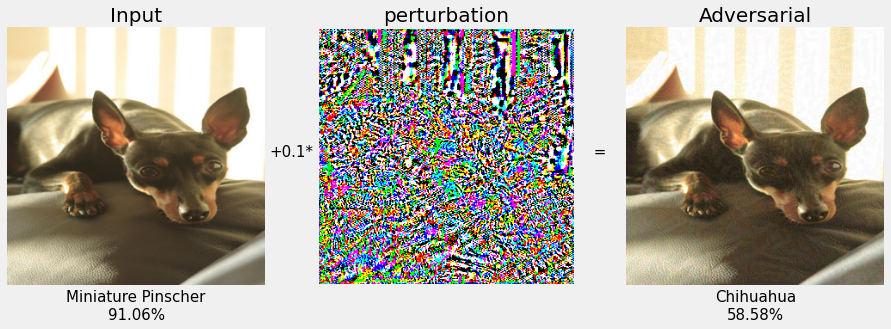

time elapsed 3065 milli seconds
Peak memory usage in MB:  11.462818145751953


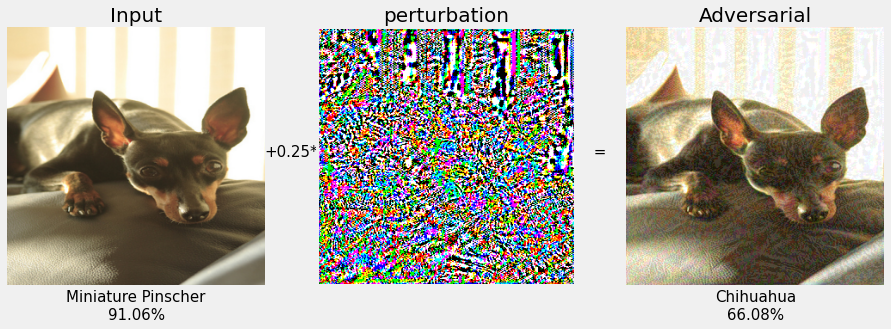

time elapsed 3060 milli seconds
Peak memory usage in MB:  11.46205997467041


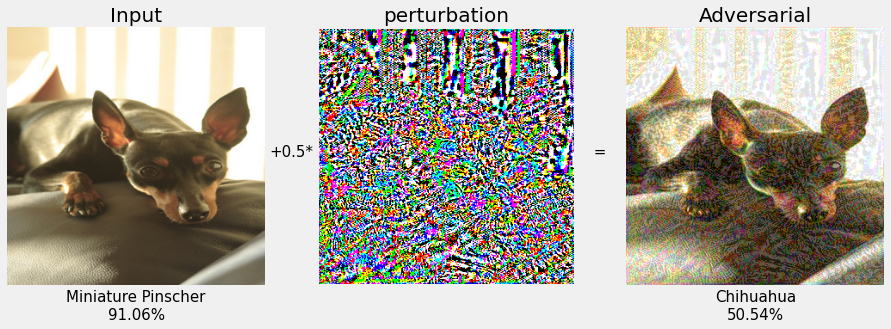

time elapsed 3098 milli seconds
Peak memory usage in MB:  11.484233856201172


In [26]:
"""
Apply FGSM to the input image showing effects of a range of epsilon values.
"""

for i in epsilon: #Iterate through all epsilon values
  tracing_start() #Start memory usage tracing
  start = time.time() #Start time tracking
  
  x_grad, x_fgsm, epsilon_fgsm = fgsm(label_idx, output, image_variable, i) #Apply FGSM to the input using current epsilon

  fgsm_pred, fgsm_pred_prob = classify_adv(x_fgsm) #Classify the generated adversarial example
  
  #Visualise the images
  visualise(image_tensor, x_fgsm, x_grad, i, x_pred, fgsm_pred, x_pred_prob, fgsm_pred_prob, MEAN, STD)
  
  end = time.time() #Stop time tracking
  print("time elapsed {} milli seconds".format(int((end-start)*1000))) #Print time taken for this iteration
  trace_peak_memory() #Print the maximum memory usage in this iteration

<h5>Selection of random images</h5>

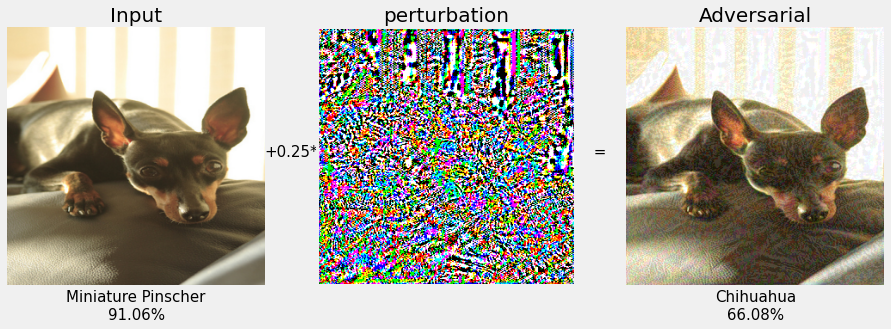

time elapsed 4117 milli seconds
Peak memory usage in MB:  11.515298843383789


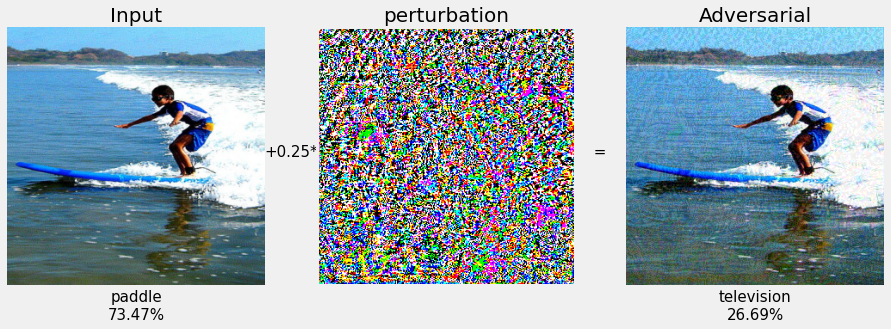

time elapsed 3989 milli seconds
Peak memory usage in MB:  11.534430503845215


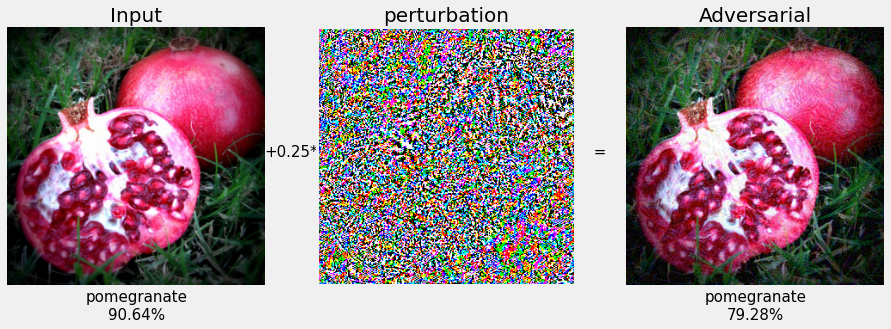

time elapsed 4001 milli seconds
Peak memory usage in MB:  11.532794952392578


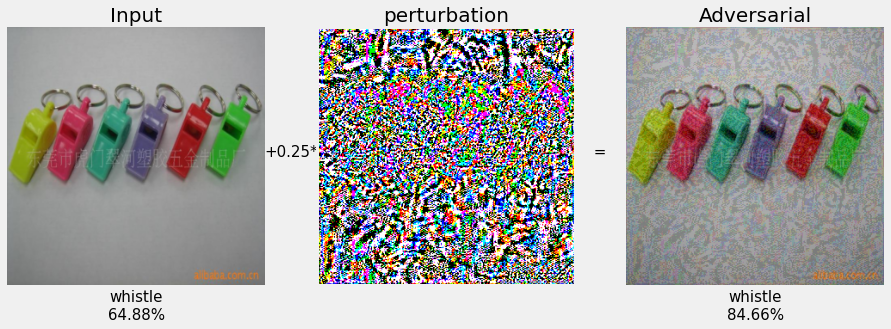

time elapsed 3976 milli seconds
Peak memory usage in MB:  11.532276153564453


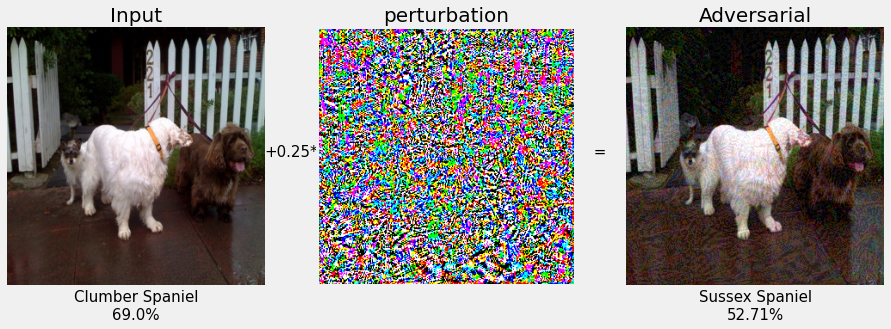

time elapsed 4237 milli seconds
Peak memory usage in MB:  11.54649829864502


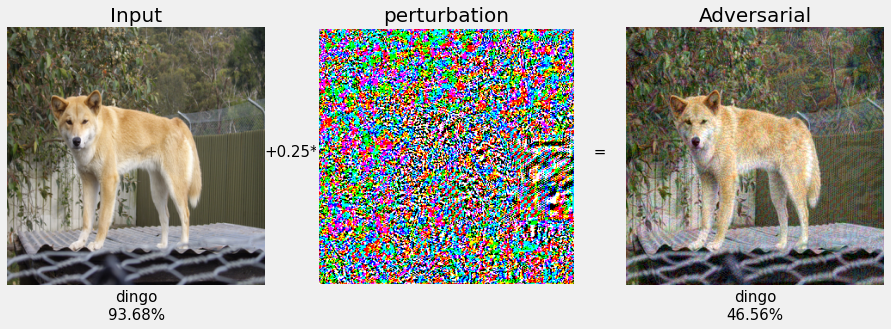

time elapsed 4051 milli seconds
Peak memory usage in MB:  11.535245895385742


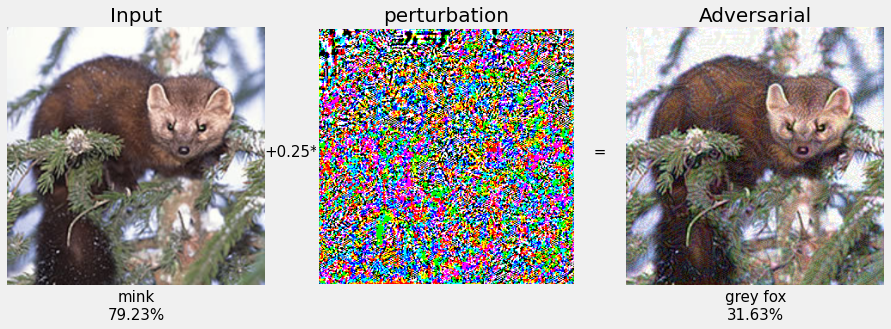

time elapsed 4061 milli seconds
Peak memory usage in MB:  11.53438949584961


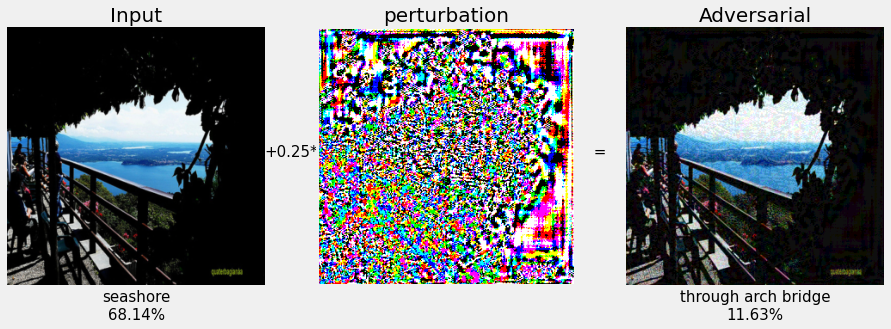

time elapsed 4047 milli seconds
Peak memory usage in MB:  11.534491539001465


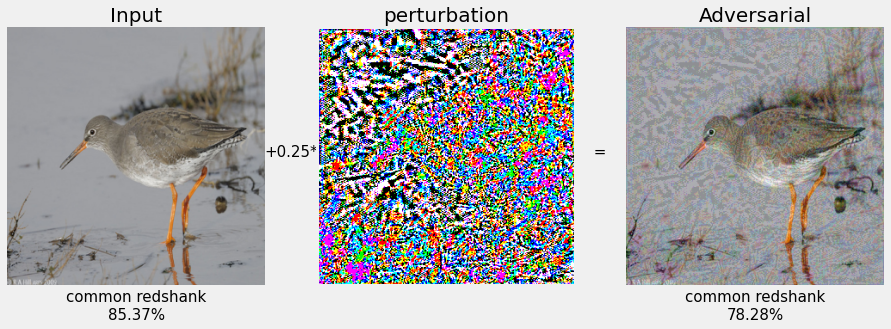

time elapsed 4233 milli seconds
Peak memory usage in MB:  11.538249969482422


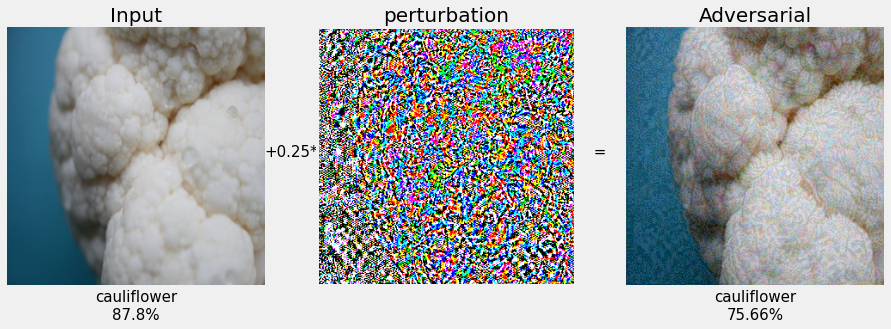

time elapsed 4082 milli seconds
Peak memory usage in MB:  11.534037590026855


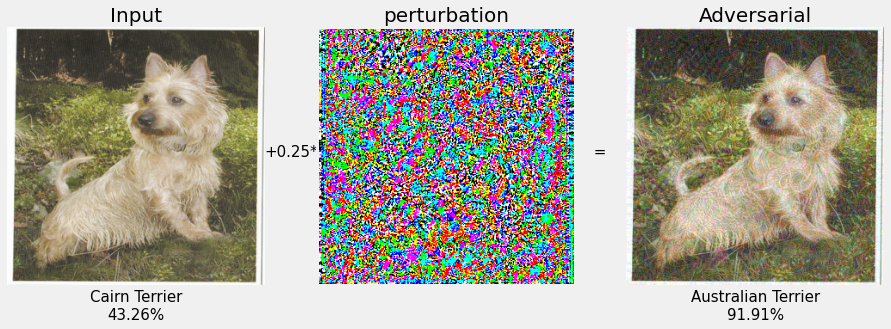

time elapsed 3961 milli seconds
Peak memory usage in MB:  11.535055160522461


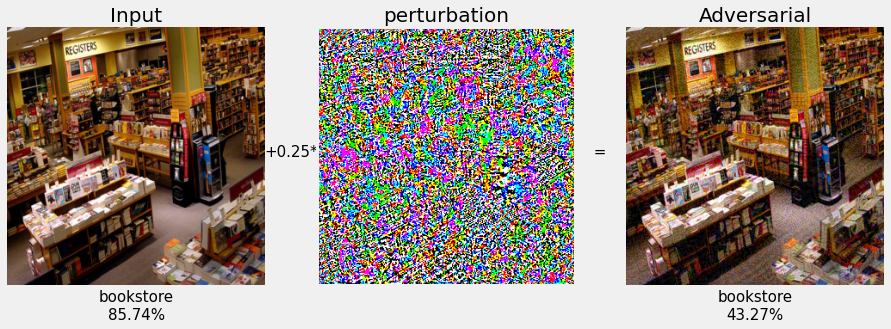

time elapsed 4004 milli seconds
Peak memory usage in MB:  11.534041404724121


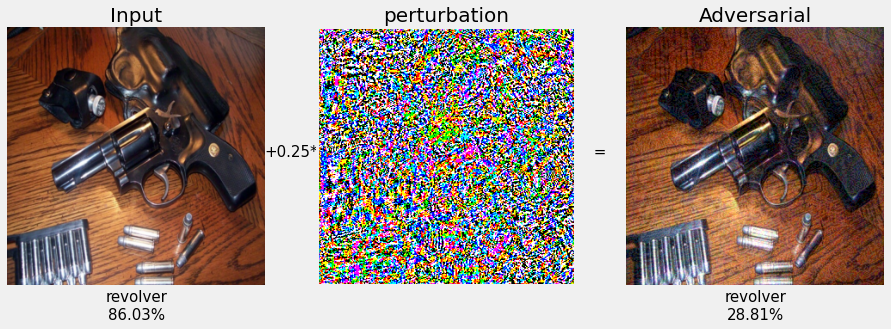

time elapsed 3951 milli seconds
Peak memory usage in MB:  11.533825874328613


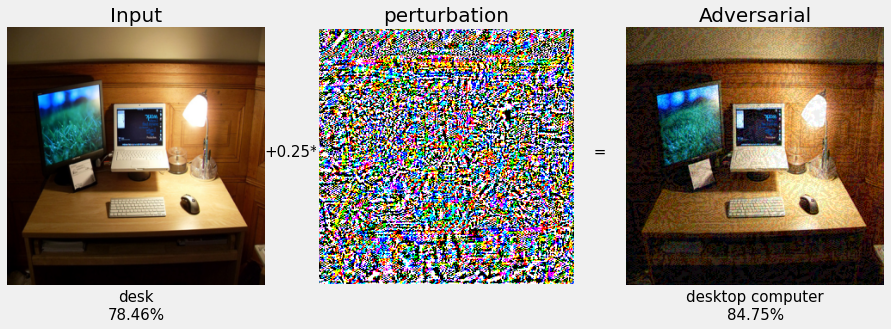

time elapsed 3963 milli seconds
Peak memory usage in MB:  11.533875465393066


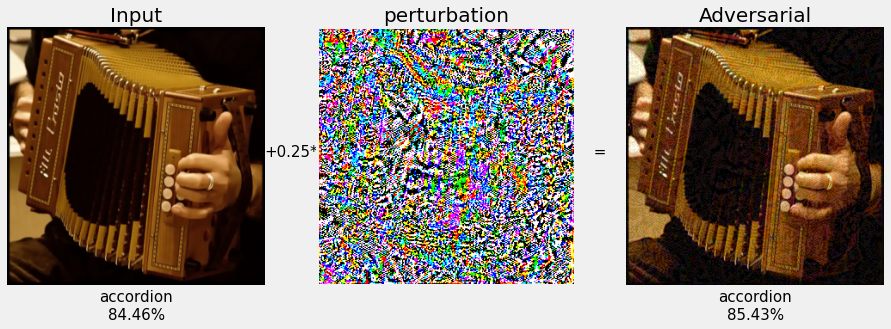

time elapsed 4100 milli seconds
Peak memory usage in MB:  11.546075820922852


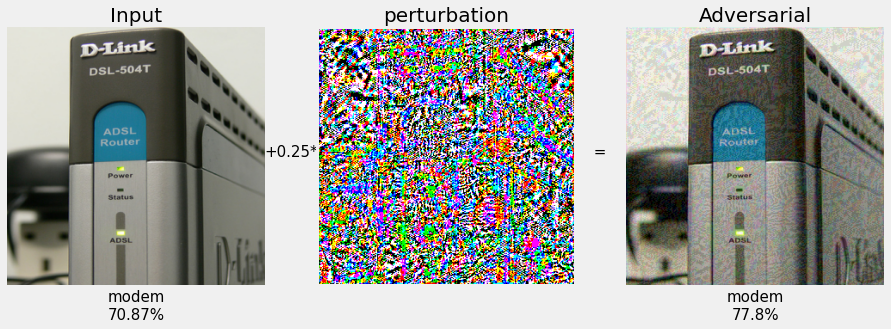

time elapsed 4008 milli seconds
Peak memory usage in MB:  11.535198211669922


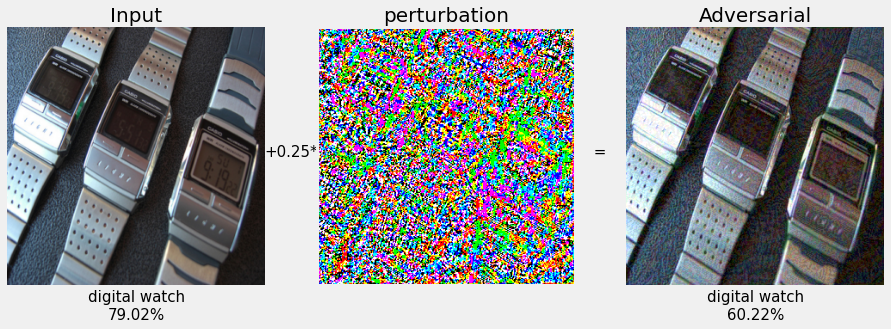

time elapsed 3991 milli seconds
Peak memory usage in MB:  11.537956237792969


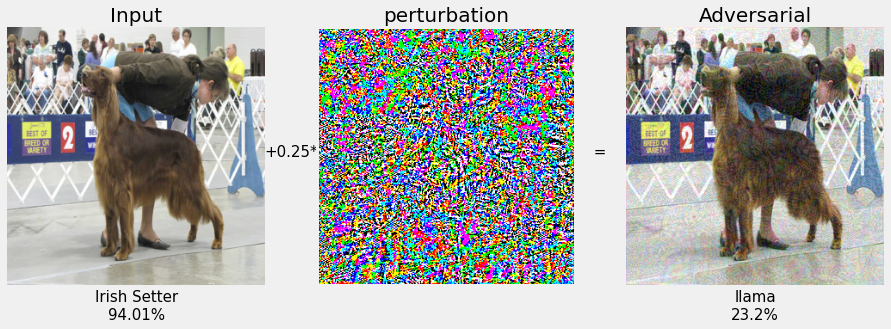

time elapsed 4035 milli seconds
Peak memory usage in MB:  11.534790992736816


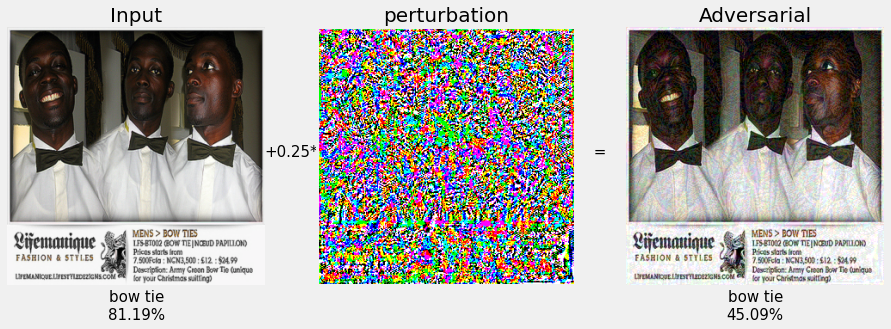

time elapsed 3992 milli seconds
Peak memory usage in MB:  11.533821105957031


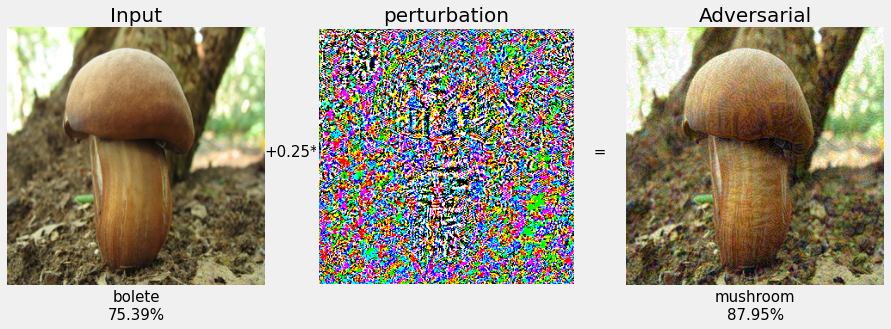

time elapsed 3971 milli seconds
Peak memory usage in MB:  11.533843040466309


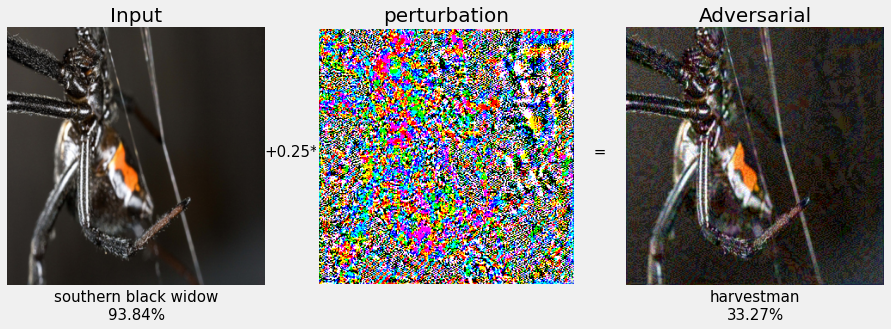

time elapsed 3975 milli seconds
Peak memory usage in MB:  11.533958435058594


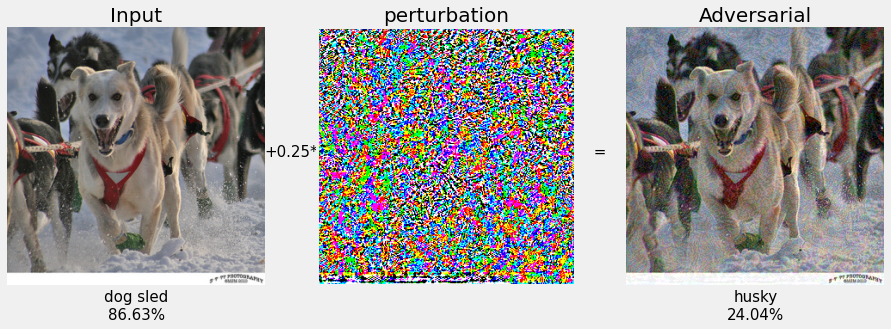

time elapsed 4025 milli seconds
Peak memory usage in MB:  11.53421401977539


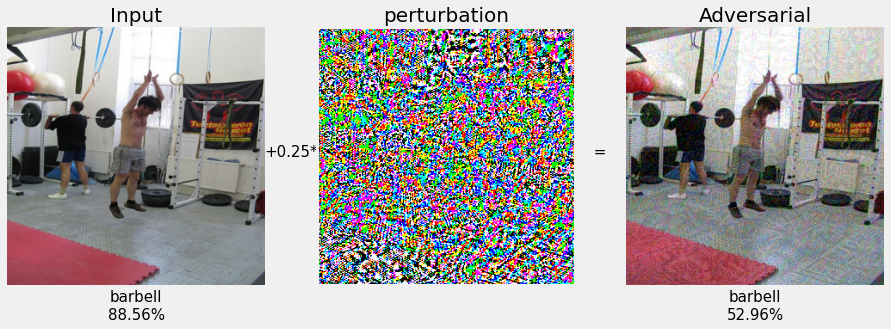

time elapsed 3986 milli seconds
Peak memory usage in MB:  11.535470962524414


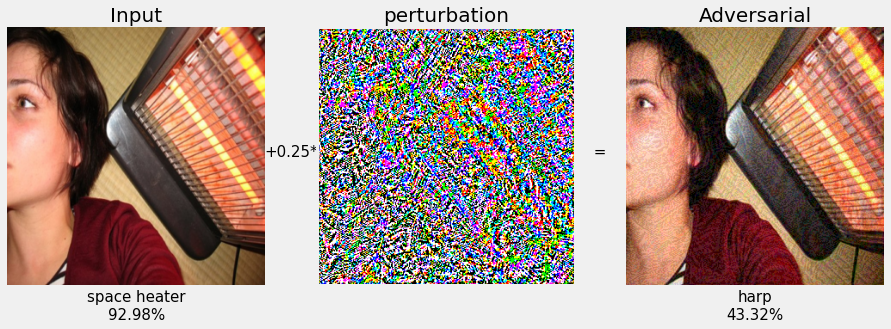

time elapsed 4021 milli seconds
Peak memory usage in MB:  11.53498363494873


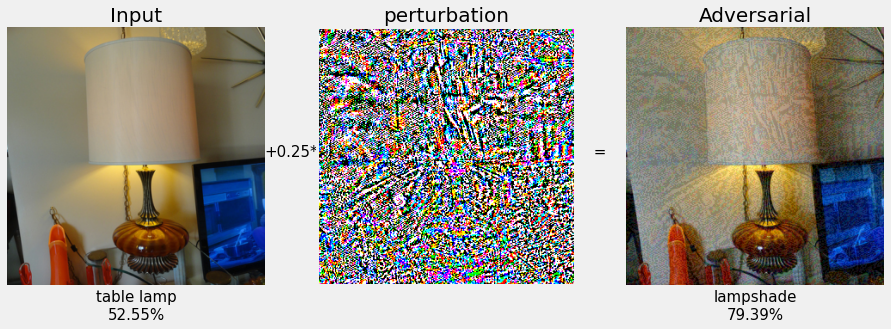

time elapsed 4159 milli seconds
Peak memory usage in MB:  11.546147346496582


In [27]:
"""
Apply FGSM to the selection of random images.
"""
epsilon =  0.25 #Set epsilon to 0.25 as according to the paper it is introduced in that should work 99.9% of the time.

for i in range(len(showcase_images)): #Loop through number of images
  tracing_start() #Start tracing memory
  start = time.time() #Get start time
  
  image = showcase_images[i] #Load the image for this iteration
  #Classify the image
  image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)

  x_pred = (x_pred[:30] + '..') if len(x_pred) > 30 else x_pred #Truncate prediction so it fits on plot
  
  x_grad, x_fgsm, epsilon_fgsm = fgsm(label_idx, output, image_variable, epsilon) #Apply FGSM to the input using current epsilon

  fgsm_pred, fgsm_pred_prob = classify_adv(x_fgsm) #Classify the generated adversarial example
  
  fgsm_pred = (fgsm_pred[:30] + '..') if len(fgsm_pred) > 30 else fgsm_pred #Truncate prediction so it fits on plot
  
  #Visualise the images
  visualise(image_tensor, x_fgsm, x_grad, epsilon, x_pred, fgsm_pred, x_pred_prob, fgsm_pred_prob, MEAN, STD)
  
  end = time.time() #Get end time
  print("time elapsed {} milli seconds".format(int((end-start)*1000))) #Print time taken
  trace_peak_memory() #Show peak memory usage
  

Peak memory usage in MB:  0.5169773101806641
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5163593292236328
Peak memor

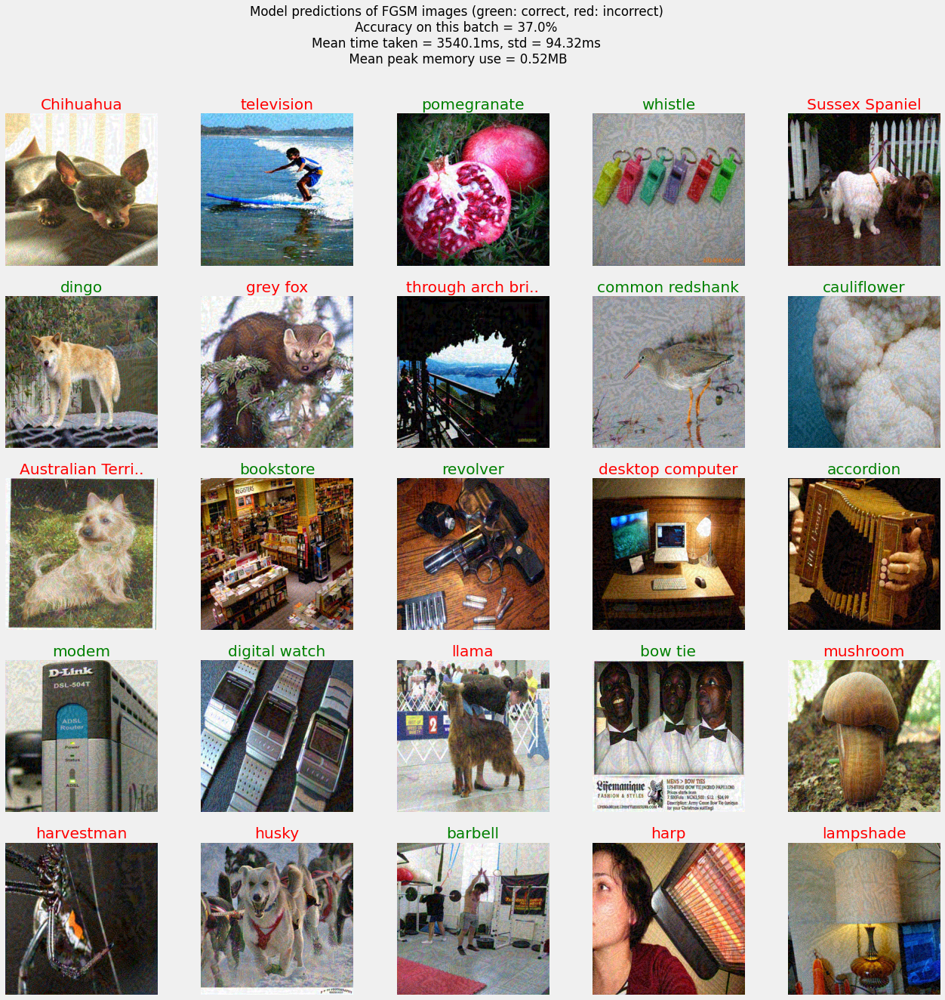

In [28]:
epsilon =  0.25 #Set epsilon to 0.25 as according to the paper it is introduced in that should work 99.9% of the time.

plt.figure(figsize=(20,20)) #Specifying the overall grid size

correct = 0 #Record number of correct predictions

total_time = []
total_mem = []

for i in range(len(showcase_images)): #Iterate through number of images
  tracing_start() #Start tracing memory
  start = time.time() #Get start time
  
  image = showcase_images[i] #Load image for this iteration
  
  #Classify input image
  image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)
  
  x_fgsm = fgsm(label_idx, output, image_variable, epsilon)[1] #Apply FGSM to the input using current epsilon
  fgsm_pred = classify_adv(x_fgsm)[0] #Classify FGSM generated image
  
  end = time.time() #Get end time
  total_time.append(float((end-start)*1000))
  mem = trace_peak_memory() #Show peak memory usage
  total_mem.append(float(mem))
  
  #Process FGSM image so it may be displayed
  x_fgsm = x_fgsm.squeeze(0)
  x_fgsm = x_fgsm.mul(torch.FloatTensor(STD).view(3,1,1)).add(torch.FloatTensor(MEAN).view(3,1,1)).numpy()
  x_fgsm = np.transpose( x_fgsm , (1,2,0))
  x_fgsm = np.clip(x_fgsm, 0, 1)
  
  plt.subplot(5,5,i+1) #The number of images in the grid is 5*5 (25)
  plt.imshow(x_fgsm) #Show the image
  
  if fgsm_pred == x_pred: #If fgsm predicted label is the same as input predicted label
    correct += 1 #Increment correct counter
    color = "green" #Set the colour for the title to be green
  else:
    color = "red" #Set the colour for the title to be red
    
  fgsm_pred = (fgsm_pred[:16] + '..') if len(fgsm_pred) > 16 else fgsm_pred #Truncate FGSM image prediction
  
  plt.title(fgsm_pred, color=color) #Set title colour
  
  plt.grid(None) #Disable the grid lines on the image
  plt.axis('off') #Disable the axis

for j in input_images:
  tracing_start() #Start tracing memory
  start = time.time() #Get start time
  image = j #Load image for this iteration
  
  #Classify input image
  image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)
  
  x_fgsm = fgsm(label_idx, output, image_variable, epsilon)[1] #Apply FGSM to the input using current epsilon
  fgsm_pred = classify_adv(x_fgsm)[0] #Classify FGSM generated image
  
  end = time.time() #Get end time
  total_time.append(float((end-start)*1000))
  #print("time elapsed {} milli seconds".format(int((end-start)*1000))) #Print time taken
  mem = trace_peak_memory() #Show peak memory usage
  total_mem.append(float(mem))
  
  if fgsm_pred == x_pred: #If fgsm predicted label is the same as input predicted label
    correct += 1 #Increment correct counter

accuracy = round(((correct / (len(showcase_images) + len(input_images))) * 100),5) #Calculate the accuracy over this batch

mean_time = round(np.mean(total_time),2)
std_time = round(np.std(total_time),2)
mean_mem = round(np.mean(total_mem),2)

#Set overall plot title and display it
title = ("Model predictions of FGSM images (green: correct, red: incorrect)\nAccuracy on this batch = "
         + str(accuracy) + "%\nMean time taken = " + str(mean_time) + "ms, std = " + str(std_time) + 
         "ms\n Mean peak memory use = " + str(mean_mem)+"MB")
_ = plt.suptitle(title)
plt.show()

<h2>Iterative Least Likely Class Method (ILLCM) (Optional)</h2>

<h4>Implementation function<h4>

In [29]:
def illcm(class_Output, original_Tensor, epsilon, num_steps, alpha):
    """Implement the Iterative Least Likely Class method.

    Args:
        class_Output (torch.Tensor): The output data of the classification of the original image.
        original_Tensor (torch.Tensor): The original tensor image.
        epsilon (float): The epsilon value for the formula.
        num_steps (int): The number of steps to be iterated through.
        alpha (float): A parameter for the ILLCM formula.

    Returns:
        illcm_image (torch.Tensor): The adversarial example generated.
        total_grad (torch.Tensor): The perturbation generated by the function.
    """
    y_LL = int(torch.min(class_Output.data, 1)[1][0]) #Find the class the input image is least likely to be
    y_LL = Variable(torch.LongTensor([y_LL]), requires_grad=False) #Comvert to variable
    
    image_variable.data = original_Tensor
    
    for i in range(num_steps): #Iterate through each step
        zero_gradients(image_variable) #Use the zero_gradients function from utility_functions.py to zero the gradients
    
        output = model.forward(image_variable) #Perform forward pass
        loss = torch.nn.CrossEntropyLoss()
        loss_cal = loss(output, y_LL) #Calculate cross entropy loss between output and target
        loss_cal.backward() #Calculate gradient of each variable
        
        illcm_grad = alpha * torch.sign(image_variable.grad.data) #Multiply the zeroed image_variable by alpha
        illcm_temp = image_variable.data - illcm_grad
        
        total_grad = illcm_temp - image_tensor # Remove the oringal tensor from the perturbation tensor
        total_grad = torch.clamp(total_grad, -epsilon, epsilon)
        
        illcm_adv = image_tensor + total_grad #Add the oringal and final perturbation tensor
        image_variable.data = illcm_adv
        illcm_image = image_variable.data
    
    return illcm_image, total_grad

<h4>Single image</h5>

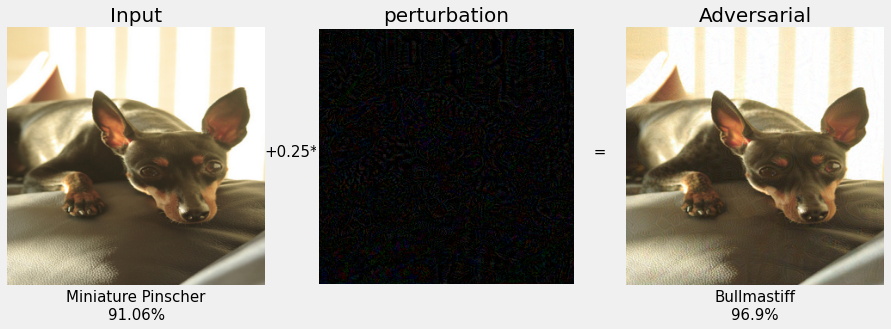

In [30]:
"""
Applying ILLCM to a single image.
"""
epsilon = 0.25 #Set epsilon value
num_steps = 5 #Set number of steps
alpha = 0.025 #Set alpha value, a parameter in the ILLCM formula

image = showcase_images[0] #Load the image on specified path as a PIL image

image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)

illcm_adv, final_illcm = illcm(output, image_tensor, epsilon, num_steps, alpha)

illcm_pred, illcm_pred_prob = classify_adv(illcm_adv) #Classify the generated adversarial example

visualise(image_tensor, illcm_adv.data, final_illcm, epsilon, x_pred, illcm_pred, x_pred_prob, illcm_pred_prob, MEAN, STD)

<h4>Batch of images</h4>

Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5162372589111328
Peak memory usage in MB:  0.5163593292236328
Peak memory usage in MB:  0.5163593292236328
Peak memor

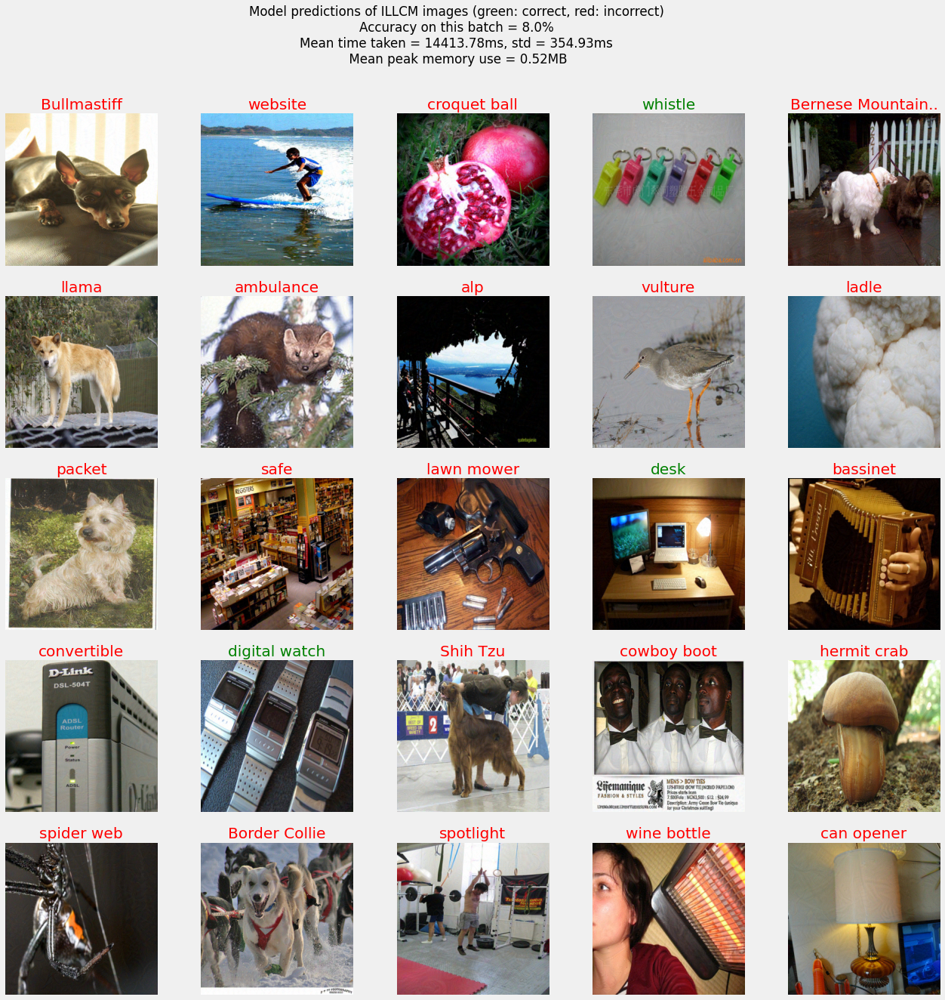

In [31]:
"""
Applying ILLCM to the batch of random test images.
"""
epsilon = 0.25 #Set epsilon value
num_steps = 5 #Set number of steps
alpha = 0.025 #Set alpha value, a parameter in the ILLCM formula

plt.figure(figsize=(20,20)) #Specifying the overall grid size

correct = 0 #Record number of correct predictions

total_time = []
total_mem = []

for i in range(len(showcase_images)): #Iterate through number of images
  tracing_start() #Start tracing memory
  start = time.time() #Get start time
  
  image = showcase_images[i] #Load image for this iteration
  
  #Classify input image
  image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)
  
  illcm_adv = illcm(output, image_tensor, epsilon, num_steps, alpha)[0] #Apply ILLCM to the input
  illcm_pred = classify_adv(illcm_adv)[0] #Classify the generated adversarial example
  
  end = time.time() #Get end time
  total_time.append(float((end-start)*1000))
  mem = trace_peak_memory() #Show peak memory usage
  total_mem.append(float(mem))
  
  #Process ILLCM image so it may be displayed
  illcm_adv.data = illcm_adv.squeeze(0)
  illcm_adv = illcm_adv.mul(torch.FloatTensor(STD).view(3,1,1)).add(torch.FloatTensor(MEAN).view(3,1,1)).numpy()
  illcm_adv = np.transpose( illcm_adv , (1,2,0))
  illcm_adv = np.clip(illcm_adv, 0, 1)
  
  plt.subplot(5,5,i+1) #The number of images in the grid is 5*5 (25)
  plt.imshow(illcm_adv) #Show the image
  
  if illcm_pred == x_pred: #If ILLCM predicted label is the same as input predicted label
    correct += 1 #Increment correct counter
    color = "green" #Set the colour for the title to be green
  else:
    color = "red" #Set the colour for the title to be red
    
  illcm_pred = (illcm_pred[:16] + '..') if len(illcm_pred) > 16 else illcm_pred #Truncate ILLCM image prediction
  
  plt.title(illcm_pred, color=color) #Set title colour
  
  plt.grid(None) #Disable the grid lines on the image
  plt.axis('off') #Disable the axis

for j in input_images:
  tracing_start() #Start tracing memory
  start = time.time() #Get start time
  image = j #Load image for this iteration
  
  #Classify input image
  image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)
  
  illcm_adv = illcm(output, image_tensor, epsilon, num_steps, alpha)[0] #Apply ILLCM to the input
  illcm_pred = classify_adv(illcm_adv)[0] #Classify the generated adversarial example
  
  end = time.time() #Get end time
  total_time.append(float((end-start)*1000))
  mem = trace_peak_memory() #Show peak memory usage
  total_mem.append(float(mem))
  
  if illcm_pred == x_pred: #If ILLCM predicted label is the same as input predicted label
    correct += 1 #Increment correct counter


accuracy = round(((correct / (len(showcase_images) + len(input_images))) * 100),5) #Calculate the accuracy over this batch

mean_time = round(np.mean(total_time),2)
std_time = round(np.std(total_time),2)
mean_mem = round(np.mean(total_mem),2)

#Set overall plot title and display it
title = ("Model predictions of ILLCM images (green: correct, red: incorrect)\nAccuracy on this batch = "
         + str(accuracy) + "%\nMean time taken = " + str(mean_time) + "ms, std = " + str(std_time) + 
         "ms\n Mean peak memory use = " + str(mean_mem)+"MB")
_ = plt.suptitle(title)
plt.show()

<h2>DeepFool (Optional)</h2>

<h4>The following implementation is based off of the code provided by the researchers, Seyed-Mohsen Moosavi-Dezfooli, Alhussein Fawzi and Pascal Frossard
 who proposed the algorithm in the paper: (S. Moosavi-Dezfooli, A. Fawzi, P. Frossard: DeepFool: a simple and accurate method to fool deep neural networks. In Computer Vision and Pattern Recognition (CVPR ’16), IEEE, 2016.) it may be viewed here: https://arxiv.org/pdf/1511.04599.pdf.<br>

In order to encourage reproducible research they made their code available online to anyone on GitHub. The code implemented can be found here: https://github.com/lts4/deepfool as part of the Python directory, I have utilised their provided deepfool.py and test_deepfool.py files.</h4>

Changes made by me to the original deepfool.py file include removing references to cuda as my implementations of the other adversarial attacks did not utilise it, so for comparison reasons I removed its utilisation from deepfool as well. I also updated deepfool.py to work on the at the time latest version of PyTorch: <b>1.11.0</b> including by making it utilise my zero_gradients utility function.

I took parts from <i>test_deepfool.py</i> for the showcase of the attacks, mainly the transformations of images that allow the images to be handled by the deepfool function of <i>deepfool.py</i> I also changed parts to fit with my code and allow the probabilities of the predictions to be seen.

<h4>Preliminary (Required)</h4>

In [32]:
"""From test_deepfool.py
https://github.com/lts4/deepfool
"""
def clip_tensor(A, minv, maxv):
    """Clips the provided tensor with the min and max values provided.
    """
    A = torch.max(A, minv*torch.ones(A.shape))
    A = torch.min(A, maxv*torch.ones(A.shape))
    return A

<h4>Single image</h4>

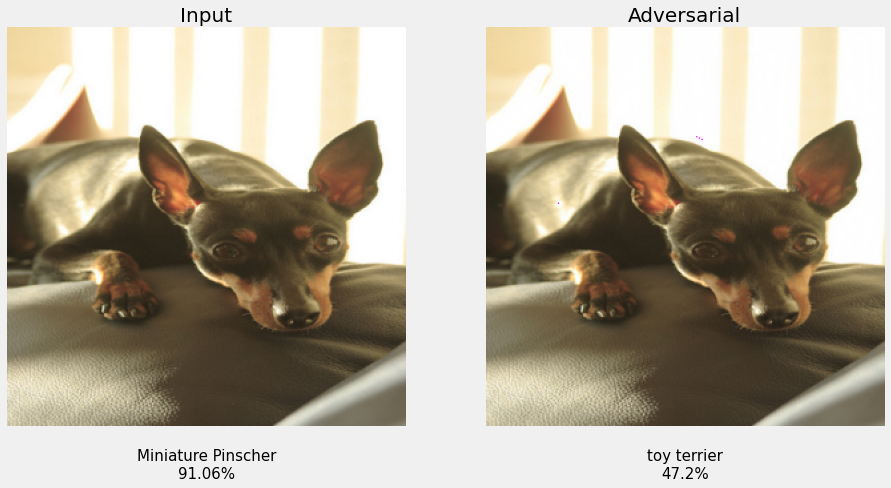

time elapsed 22455 milli seconds
Peak memory usage in MB:  10.401775360107422


10.401775360107422

In [33]:
"""
Applying DeepFool to a single image.
"""
tracing_start() #Start tracing memory
start = time.time() #Get start time
  
image = showcase_images[0] #Load the image as a PIL image

#Classify the input image
_, _, _, _, x_pred, x_pred_prob, _ = classify_input_image(image)

image = preprocess(image) #Preprocess the input image

df_image = deepfool(image, model)[4] #Apply deepfool to the input image to get the adversarial image

df_pred, df_pred_prob = classify_adv(df_image) #Classify the generated adversarial example

"""From test_deepfool.py
https://github.com/lts4/deepfool
"""
clip = lambda x: clip_tensor(x, 0, 255)

#Normalise the tensor about the mean and standard deviation and convert to PIL format
tf = transforms.Compose([transforms.Normalize(mean=[0, 0, 0], std=list(map(lambda x: 1 / x, STD))),
                         transforms.Normalize(mean=list(map(lambda x: -x, MEAN)), std=[1, 1, 1]),
                         transforms.Lambda(clip),
                         transforms.ToPILImage(),
                         ])
"""End of from test_deepfool.py"""
df_adv = tf(df_image.cpu()[0])

x_pred = (x_pred[:30] + '..') if len(x_pred) > 30 else x_pred #Truncate original image prediction
df_pred = (df_pred[:30] + '..') if len(df_pred) > 30 else df_pred #Truncate DeepFool image prediction

figure, ax = plt.subplots(1,2, figsize=(14,8)) #Define the figure with subplots

ax[0].imshow(tf(image)) #Show input image transformed by tf
ax[0].set_title('Input', fontsize=20) #Set input title
ax[0].axis('off') #Disable axis
ax[0].text(0.5,-0.13, "{}\n{}%".format(x_pred, round(x_pred_prob, 2)), size=15, ha="center", 
         transform=ax[0].transAxes) #Write the predicted class and probability

ax[1].imshow(df_adv) #Show adversarial image transformed by tf
ax[1].set_title('Adversarial', fontsize=20) #Set input title
ax[1].axis('off') #Disable axis
ax[1].text(0.5,-0.13, "{}\n{}%".format(df_pred, round(df_pred_prob, 2)), size=15, ha="center", 
           transform=ax[1].transAxes) #Write the predicted class and probability

plt.show() #Show figure

end = time.time() #Get end time
print("time elapsed {} milli seconds".format(int((end-start)*1000))) #Print time taken
trace_peak_memory() #Show peak memory usage

<h4>Batch of images</h4>

Peak memory usage in MB:  10.393957138061523
Peak memory usage in MB:  10.391911506652832
Peak memory usage in MB:  10.39195728302002
Peak memory usage in MB:  10.392003059387207
Peak memory usage in MB:  10.391545295715332
Peak memory usage in MB:  10.391453742980957
Peak memory usage in MB:  10.391499519348145
Peak memory usage in MB:  10.391545295715332
Peak memory usage in MB:  10.391133308410645
Peak memory usage in MB:  10.391545295715332
Peak memory usage in MB:  10.391453742980957
Peak memory usage in MB:  10.391179084777832
Peak memory usage in MB:  10.391545295715332
Peak memory usage in MB:  10.391133308410645
Peak memory usage in MB:  10.39122486114502
Peak memory usage in MB:  10.39140796661377
Peak memory usage in MB:  10.391499519348145
Peak memory usage in MB:  10.391499519348145
Peak memory usage in MB:  10.391499519348145
Peak memory usage in MB:  10.391545295715332
Peak memory usage in MB:  10.391179084777832
Peak memory usage in MB:  10.391133308410645
Peak memory u

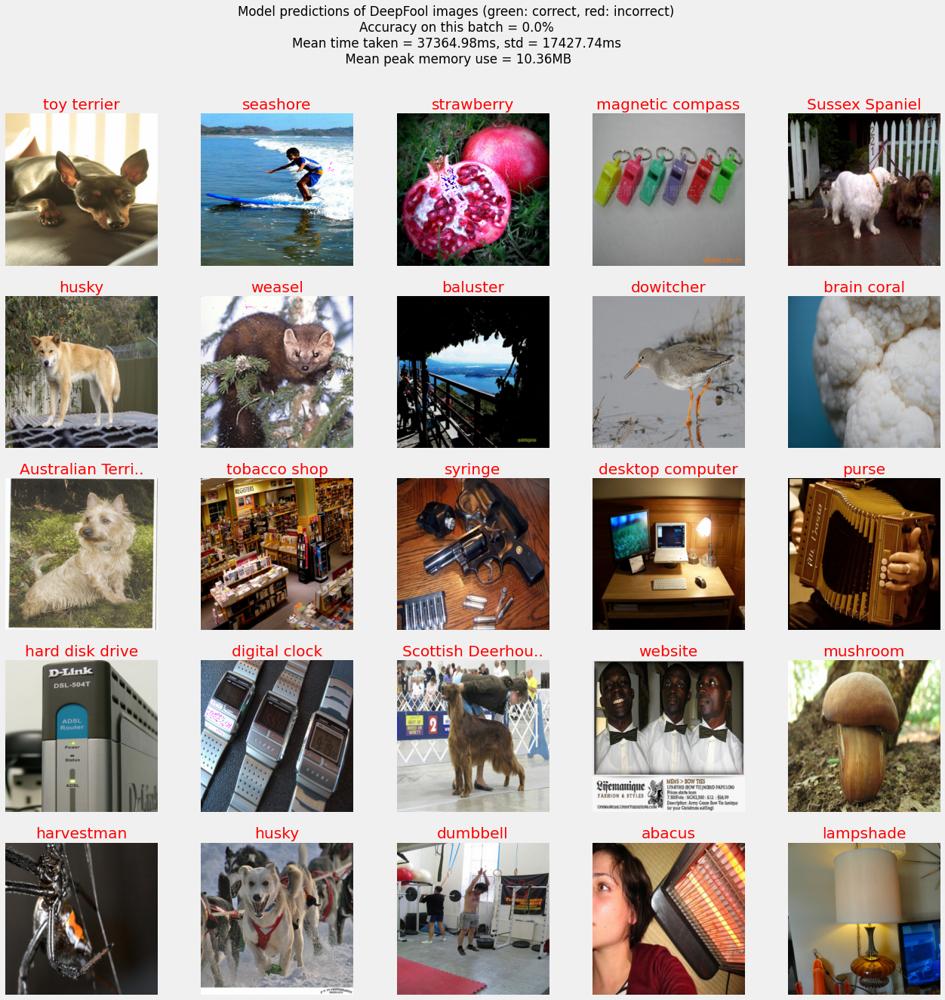

In [34]:
"""
Applying DeepFool to the batch of random test images.
"""

plt.figure(figsize=(20,20)) #Specifying the overall grid size

correct = 0 #Record number of correct predictions

total_time = []
total_mem = []

for i in range(len(showcase_images)): #Iterate through number of images
  tracing_start() #Start tracing memory
  start = time.time() #Get start time
  
  image = showcase_images[i] #Load image for this iteration
  
  #Classify input image
  _, _, _, _, x_pred, x_pred_prob, _ = classify_input_image(image)
  
  image = preprocess(image) #Preprocess the input image

  df_image = deepfool(image, model)[4] #Apply deepfool to the input image to get the adversarial image

  df_pred, df_pred_prob = classify_adv(df_image) #Classify the generated adversarial example
  
  end = time.time() #Get end time
  total_time.append(float((end-start)*1000))
  mem = trace_peak_memory() #Show peak memory usage
  total_mem.append(float(mem))
  
  """From test_deepfool.py"""
  clip = lambda x: clip_tensor(x, 0, 255)

  #Normalise the tensor about the mean and standard deviation and convert to PIL format
  tf = transforms.Compose([transforms.Normalize(mean=[0, 0, 0], std=list(map(lambda x: 1 / x, STD))),
                           transforms.Normalize(mean=list(map(lambda x: -x, MEAN)), std=[1, 1, 1]),
                           transforms.Lambda(clip),
                           transforms.ToPILImage(),
                           ])
  """End of from test_deepfool.py"""
  
  df_adv = tf(df_image.cpu()[0])
  
  plt.subplot(5,5,i+1) #The number of images in the grid is 5*5 (25)
  plt.imshow(df_adv) #Show the image
  
  if df_pred == x_pred: #If DeepFool predicted label is the same as input predicted label
    correct += 1 #Increment correct counter
    color = "green" #Set the colour for the title to be green
  else:
    color = "red" #Set the colour for the title to be red
    
  df_pred = (df_pred[:16] + '..') if len(df_pred) > 16 else df_pred #Truncate DeepFool image prediction
  
  plt.title(df_pred, color=color) #Set title colour
  
  plt.grid(None) #Disable the grid lines on the image
  plt.axis('off') #Disable the axis

for j in input_images:
  tracing_start() #Start tracing memory
  start = time.time() #Get start time
  image = j #Load image for this iteration
  
  #Classify input image
  image_tensor, image_variable, output, label_idx, x_pred, x_pred_prob, output_probs = classify_input_image(image)
  
  image = preprocess(image)
  df_image = deepfool(image, model)[4] #Apply deepfool to the input image to get the adversarial image

  df_pred, df_pred_prob = classify_adv(df_image) #Classify the generated adversarial example
  
  end = time.time() #Get end time
  total_time.append(float((end-start)*1000))
  #print("time elapsed {} milli seconds".format(int((end-start)*1000))) #Print time taken
  mem = trace_peak_memory() #Show peak memory usage
  total_mem.append(float(mem))
  
  if df_pred == x_pred: #If DeepFool predicted label is the same as input predicted label
    correct += 1 #Increment correct counter

accuracy = round(((correct / (len(showcase_images) + len(input_images))) * 100),5) #Calculate the accuracy over this batch

mean_time = round(np.mean(total_time),2)
std_time = round(np.std(total_time),2)
mean_mem = round(np.mean(total_mem),2)

#Set overall plot title and display it
title = ("Model predictions of DeepFool images (green: correct, red: incorrect)\nAccuracy on this batch = "
         + str(accuracy) + "%\nMean time taken = " + str(mean_time) + "ms, std = " + str(std_time) + 
         "ms\n Mean peak memory use = " + str(mean_mem)+"MB")
_ = plt.suptitle(title)
plt.show()